# Random forest CV template

In [41]:
# imports
import numpy as np
import pandas as pd
pd.options.mode.chained_assignment = None  # default='warn'
import matplotlib.pyplot as plt

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, plot_confusion_matrix

**Load the dataset and specify columns to use.**

In [20]:
column_list = ["age", "sex", "race", "juv_fel_count", "juv_misd_count", "juv_other_count",
               "priors_count", "two_year_recid", "days_b_screening_arrest"]

df = pd.read_csv("https://raw.githubusercontent.com/suneman/socialdata2022/main/files/recidivism_dataset_sub.csv", usecols=column_list)

## Build a random forest for classification

Perform preprocessing to only keep specific records

In [21]:
# only keep records that have between -30 and 30 days between the arrest and screening.
df = df.loc[(df['days_b_screening_arrest'] > -30) & (df['days_b_screening_arrest'] < 30)]

# drop the column
df = df.drop(columns=['days_b_screening_arrest'])

# reset index after the columns are dropped
df = df.reset_index(drop=True)

Now we encode the sex and race categorical variables with `OneHotEncoder`.

In [22]:
# import OneHotEncoder
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder()

# set the categorical variables to encode inside X: 'sex' and 'race'
categorical_var = ['sex', 'race']
X = df[categorical_var]

# fit the encoder to our X df
ohe.fit(X)

# create matrix
mat = ohe.transform(X).toarray()

# retrieve category names
names = ohe.get_feature_names_out(categorical_var)

# finalize the encoded df
df_encoded = pd.concat([df, pd.DataFrame(mat, columns=names)], axis=1)

**Split the data in Train/Test sets by using a 70/30 split and `random_state=42`**

In [23]:
# imports
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
seed = 42 # set random seed to 42!

We specify the features to use, and create X, y to train the model. For sex we decided to only use sex_Male, since sex_Male being 0 or 1 directly indicates that sex_Female is 1 or 0. Keeping both would just increase the dimensionality and not provide any useful information.

In [24]:
# set the features - only use sex_male since 0 indicates female
features = ['age', 'sex_Male', 'juv_fel_count', 'juv_misd_count', 'juv_other_count', 'priors_count', \
            'race_African-American', 'race_Asian', 'race_Caucasian', 'race_Hispanic', 'race_Native American', 'race_Other']

# create X, y
X = df_encoded[features]
y = df_encoded['two_year_recid']

# perform the train/test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=seed, stratify=y)

**We create a Random Forest classifier with default parameters, train the model, and store the predictions.**

In [25]:
# build a model using default parameters
clf = RandomForestClassifier(random_state=seed) 

# Train the model on training data
clf.fit(X_train, y_train)

# store predictions and class labels
predictions_clf = clf.predict(X_test)
class_labels = list(set(y))

**Below we show a classification report broken down between the targets of 0 (No) and 1 (Yes), along with a confusion matrix.**

Random Forest Recidivism - Classification report:
               precision    recall  f1-score   support

           0       0.65      0.70      0.67      1007
           1       0.61      0.55      0.58       841

    accuracy                           0.63      1848
   macro avg       0.63      0.63      0.63      1848
weighted avg       0.63      0.63      0.63      1848



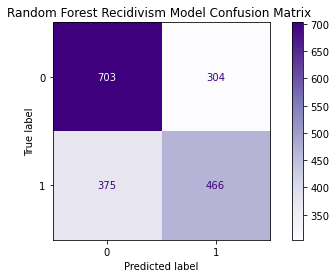

In [26]:
print("Random Forest Recidivism - Classification report:\n", classification_report(y_test, predictions_clf))
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, display_labels=class_labels, cmap = plt.cm.Purples, ax=ax)
_ = ax.set_title('Random Forest Recidivism Model Confusion Matrix ')

> * What are your thoughts on these metrics? Is accuracy a good measure?
>      * <font color='#7A378B'> The metrics do not show that the model performs particularly well. There are clear differences between how the model performs for each class: the precision and recall is higher for results classified as 0 than for results classified as 1. This should be investigated. An accuracy of 63% does not confirm that the model performs well. Accuracy is simply TP + TN / all predictions, and does not take into account how the dataset is balanced. This specfic model would have incorrectly classified 304 people as going to recommit a crime, and missed 375 people who would have actually recomitted a crime. This model should not be running in real life and impacting people's lives.
>      * "Overall accuracy can be misleading when the class distribution is imbalanced, and it is critical to predict the minority class correctly." [from deepchecks](https://deepchecks.com/how-to-check-the-accuracy-of-your-machine-learning-model/). Our dataset contains 45% non-redicivized and 55% recidivized, so the imabalance is not extremely large, but it could be impacting the accuracy, as explained in this [article](https://towardsdatascience.com/why-accuracy-isnt-everything-precision-and-recall-simply-explained-25bc093c7cda). For instance, if the dataset contained 99% of recidivism, a model that would classify all nodes as recidivists would have a 99% accuracy, which sounds like a great performance. Clearly, accuracy is then not a good measure. Likewise, Precision or Recall by themselves do not tell the whole story, hence the need for a confusion matrix.
>      * Check out the example from Data Science From Scratch (Chapter 11 page 145) for another example of "a good illustration of why we don’t typically use “accuracy” to measure how good a model is."

>   * Are your results tied to the specific hyperparameter set you used? Perform a `RandomizedSearchCV` and recompute the performance metric above with the hyperparameters found. What do you observe?
>      * <font color='#7A378B'> Model results are tied to the specific hyperparameters used within the model. For the base Random Forest used, it used the default hyperparameters as specified within the [scikit-learn documentation](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html?highlight=randomforest#sklearn.ensemble.RandomForestClassifier). Since no tuning has been done through any methods, we do not expect the model to perform well. It has not gone through any process to determine what the optimal values should be for the specific dataset.
>      * <font color='#7A378B'> A model that has hyperparameters finetuned through a `RandomizedSearchCV` should perform better than a model using the default hyperperameter values. A randomized search crossvalidation means that the hyperperameter options will be randomly tried together, and then scoring will occur on each combination. An exhaustive review of every single possible combination does not happen (that would be a gridsearch). At the end, the hyperperameters with the best scoring results will be chosen. [scikit-learn documentation](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RandomizedSearchCV.html?highlight=randomizedsearchcv#sklearn.model_selection.RandomizedSearchCV)
>       * `n_estimators` is the number of trees in the forest. The larger, the better, but the longer the execution time.
>       * Common formulas to compute the maximum number of features to consider for each split are the square root `sqrt`and base 2 log `log2` of the total number of features. With 12 features here, `max_features` is around 3.5 .
>       * Decision Trees with infinite depth are prone to overfitting, which is why we chose to set a `max_depth`, but also train with trees of unlimited depth.
>       * `min_samples_leaf` and `min_samples_split` influence the granularity of the tree. *(how small every leaf and split can be)*
>       * When we use `bootstrap` aggregating ("bagging"), this means that the trees are not built using the whole dataset (as explained in the [Scikit Docs](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html?highlight=randomforestclassifier#:~:text=in%20version%200.19.-,bootstrapbool,-%2C%20default%3DTrue)), but with a new random sample for each tree. Bagging helps with overfitting, as different data is used for the training of each model. 
>       * This [post](https://quantdare.com/decision-trees-gini-vs-entropy/) about the differences between Gini Index and Entropy for the split explains that there is little difference in performance between the two criteria, which is why we stayed with the default 'gini'.

**Perform `RandomizedSearcgCV` for hyperparameter tuning.**

<font color='#7A378B'> When we perform `RandomizedSearchCV` below, we need to set another variable `rng` to ensure reproducible results across multiple executions, according to [scikit-learn](https://scikit-learn.org/stable/common_pitfalls.html#randomness).

In [27]:
# code adopted from https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74
from sklearn.model_selection import RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10, 20, 30]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

# set RandomState to ensure reproducible results with RandomizedSearchCV
rng = np.random.RandomState(42)

# Use the random grid to search for best hyperparameters
rf = RandomForestClassifier(random_state=rng)
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 50, 
                               cv = 3, verbose=1, random_state=rng, n_jobs = -1)
# Fit the random search model
_ = rf_random.fit(X_train, y_train)

Fitting 3 folds for each of 50 candidates, totalling 150 fits


View the parameters from the best estimator

In [32]:
rf_random.best_estimator_

RandomForestClassifier(max_depth=80, max_features='sqrt', min_samples_leaf=4,
                       min_samples_split=30, n_estimators=400,
                       random_state=RandomState(MT19937) at 0x7FBB20E8C050)

**Here we recompute the confusion matrix and accuracy scores for the model built using Randomized Search crossvalidation.**

Random Forest Recidivism - Classification report (RandomizedSearchCV):
               precision    recall  f1-score   support

           0       0.69      0.78      0.73      1007
           1       0.68      0.58      0.62       841

    accuracy                           0.69      1848
   macro avg       0.69      0.68      0.68      1848
weighted avg       0.69      0.69      0.68      1848



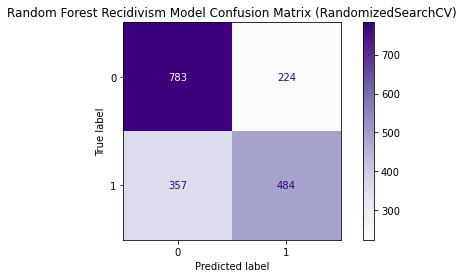

In [28]:
# store predictions and class labels
predictions_random = rf_random.predict(X_test)
# print classification report
print("Random Forest Recidivism - Classification report (RandomizedSearchCV):\n", classification_report(y_test, predictions_random))
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ConfusionMatrixDisplay.from_estimator(rf_random, X_test, y_test, display_labels=class_labels, cmap = plt.cm.Purples, ax=ax)
_ = ax.set_title('Random Forest Recidivism Model Confusion Matrix (RandomizedSearchCV)')

**We visualize one tree from the best RF estimator.**

In [29]:
from sklearn.tree import export_graphviz

# we choose the best estimator from the forest using best_estimator, and then choose a specific tree!
estimator_limited = rf_random.best_estimator_.estimators_[1]
# Export as dot file
export_graphviz(estimator_limited, 
                out_file='tree.dot', 
                feature_names = features,
                class_names = ('No','Yes'), 
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.779239 to fit


**Show feature importances by peeforming permutation feature importance**

[Code source](https://scikit-learn.org/stable/auto_examples/ensemble/plot_forest_importances.html)

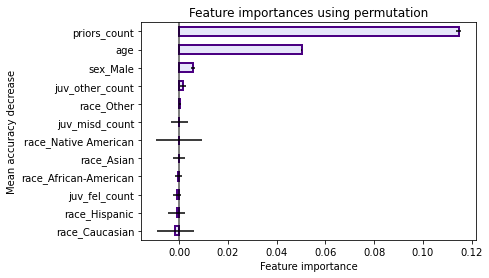

In [39]:
# feature importance
from sklearn.inspection import permutation_importance
# perform permutation feature importance
result = permutation_importance(rf_random, X_test, y_test, n_repeats=10, random_state=seed, n_jobs=2)
forest_importances = pd.Series(result.importances_mean, index=features).sort_values(ascending=True)

# plot permutation feature importance
fig, ax = plt.subplots()
ax = forest_importances.plot.barh(xerr=result.importances_std, ax=ax, color='lavender', edgecolor='indigo', linewidth=2)
ax.axvline(x=0, linestyle='-', color='black', alpha=0.5, linewidth=2)
ax.set_title("Feature importances using permutation")
ax.set_xlabel('Feature importance')
ax.set_ylabel("Mean accuracy decrease");